In [1]:
do_train = True

In [2]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python Docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load

import numpy as np
import matplotlib.pyplot as plt
import cv2

import shutil
from PIL import Image
import imagehash
import glob
import random
from tqdm import tqdm

import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from torchvision import models, transforms
from torch.utils.tensorboard import SummaryWriter

import albumentations as A
from albumentations.pytorch import ToTensorV2
from transformers import get_cosine_schedule_with_warmup
from transformers import SegformerForSemanticSegmentation

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score, roc_auc_score, confusion_matrix, classification_report

# Input data files are available in the read-only "../input/" directory
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
# for dirname, _, filenames in os.walk('/kaggle/input'):
#     for filename in filenames:
        # print(os.path.join(dirname, filename))

# You can write up to 20GB to the current directory (/kaggle/working/) that gets preserved as output when you create a version using "Save & Run All" 
# You can also write temporary files to /kaggle/temp/, but they won't be saved outside of the current session

2025-09-09 12:49:36.479764: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1757422176.831401      19 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1757422176.933426      19 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered


In [3]:
src_root = '/kaggle/input/breast-ultrasound-images-dataset/Dataset_BUSI_with_GT'
dst_root = '/kaggle/working/Dataset_BUSI_cleaned'

if not os.path.exists(dst_root):
    shutil.copytree(src_root, dst_root)
    print('copied')

copied


In [4]:
def get_image_phash(image_path):
    with Image.open(image_path) as img:
        return imagehash.phash(img)

def overlay_mask(image_path,mask_path,alpha=0.4):
    img=Image.open(image_path).convert('RGB')
    if os.path.exists(mask_path):
        mask=Image.open(mask_path).convert('L')
        mask_colored=Image.new('RGBA',img.size,(255,0,0,0))
        mask_colored.putalpha(mask.point(lambda p:int(p>0)*int(255*alpha)))
        img=img.convert('RGBA')
        img=Image.alpha_composite(img,mask_colored)
    return img

def find_and_display_near_duplicates(root,threshold=5):
    duplicates_all={}
    subfolders=['benign','malignant','normal']
    for sub in subfolders:
        folder_path=os.path.join(root,sub)
        images=sorted([f for f in os.listdir(folder_path) if f.endswith('.png') and not f.endswith('_mask.png')])
        hashes={img:get_image_phash(os.path.join(folder_path,img)) for img in images}
        compared=set()
        duplicates_all[sub]=[]
        # print(f"Near duplicates in {sub}:")
        for base_img in images:
            related=[pair for pair in images if pair!=base_img and hashes[base_img]-hashes[pair]<=threshold]
            if not related or base_img in compared:
                continue
            compared.update(related+[base_img])
            duplicates_all[sub].append([base_img]+related)
            n=len(related)+1
            # fig,axes=plt.subplots(1,n,figsize=(4*n,4))
            if n==1:
                axes=[axes]
            base_img_path=os.path.join(folder_path,base_img)
            base_mask_path=base_img_path.replace('.png','_mask.png')
            # axes[0].imshow(overlay_mask(base_img_path,base_mask_path))
            # axes[0].set_title(base_img)
            # axes[0].axis('off')
            for i,img_name in enumerate(related,1):
                img_path=os.path.join(folder_path,img_name)
                mask_path=img_path.replace('.png','_mask.png')
                # axes[i].imshow(overlay_mask(img_path,mask_path))
                # axes[i].set_title(img_name)
                # axes[i].axis('off')
            # plt.tight_layout()
            # plt.show()
    return duplicates_all

# Example usage
root=dst_root
duplicates=find_and_display_near_duplicates(root,threshold=9)
for category, groups in duplicates.items():
    print(f"\n=== {category.upper()} ===")
    for i, group in enumerate(groups, 1):
        group_str = ", ".join(group)
        print(f"{i}: {group_str}")


=== BENIGN ===
1: benign (1).png, benign (318).png
2: benign (10).png, benign (327).png
3: benign (105).png, benign (156).png
4: benign (108).png, benign (114).png, benign (94).png
5: benign (11).png, benign (328).png
6: benign (110).png, benign (158).png
7: benign (116).png, benign (114).png, benign (119).png
8: benign (12).png, benign (329).png
9: benign (122).png, benign (119).png
10: benign (127).png, benign (37).png
11: benign (128).png, benign (30).png
12: benign (129).png, benign (44).png
13: benign (13).png, benign (330).png
14: benign (130).png, benign (33).png
15: benign (131).png, benign (42).png
16: benign (132).png, benign (38).png
17: benign (133).png, benign (51).png
18: benign (134).png, benign (52).png
19: benign (135).png, benign (58).png
20: benign (136).png, benign (50).png
21: benign (138).png, benign (60).png
22: benign (139).png, benign (157).png, benign (65).png, benign (99).png
23: benign (14).png, benign (331).png
24: benign (15).png, benign (332).png
25: ben

In [5]:
keep_dict = {
    "benign": [318, 10, 156, 11, 329, 37, 30, 129, 13, 131, 38, 133, 134, 58, 136, 138, 139, 14, 15, 150, 151, 152, 25, 86, 164, 17, 35, 197, 199, 2, 290, 301, 289, 282, 262, 206, 256, 291, 209, 298, 211, 253, 260, 270, 216, 217, 218, 272, 257, 292, 278, 250, 228, 259, 230, 295, 276, 299, 261, 294, 236, 238, 258, 277, 266, 251, 284, 3, 307, 422, 423, 312, 426, 4, 322, 6, 324, 8, 395, 396, 412, 415, 94, 222, 158, 122, 33, 96, 302, 220, 246, 224, 264, 288, 305, 424, 9, 108, 21],
    "malignant": [10, 109, 110, 114, 18, 119, 88, 4, 8, 96, 34, 8, 42],
    "normal": [104, 119, 121, 122, 123, 124, 125, 28, 32, 128, 35, 5, 26, 19, 64, 50, 56, 40, 61, 42, 54, 67, 68, 60, 98, 20, 81, 68],
}

def clean_duplicates(duplicates, root, keep_dict):
    """
    duplicates: dict from previous output, keys=subfolders, values=list of lists of filenames
    keep_dict: dict, keys=subfolders, values=list of indexes to keep
    root: dataset root folder
    """
    for category, groups in duplicates.items():
        keep_indices = set(keep_dict.get(category,[]))
        folder_path = os.path.join(root, category)
        for group in groups:
            for fname in group:
                idx = int(fname.split('(')[1].split(')')[0])
                if idx not in keep_indices:
                    fpath = os.path.join(folder_path,fname)
                    mask_path = fpath.replace('.png','_mask.png')
                    if os.path.exists(fpath):
                        os.remove(fpath)
                    if os.path.exists(mask_path):
                        os.remove(mask_path)

# Usage example
root=dst_root
clean_duplicates(duplicates, root, keep_dict)


### Restart Kernel an QoL

In [6]:
from IPython.core.display import HTML
HTML("<script>Jupyter.notebook.kernel.restart()</script>")

In [7]:
os.environ["PYTORCH_CUDA_ALLOC_CONF"] = "max_split_size_mb:128"


# Class Dataset

In [8]:
class BreastCancerDataset(Dataset):
    def __init__(self, paths, transform=None, augment_classes=["malignant","normal"],
                 dup_factor=2, mode="train"):
        """
        paths: list of mask paths
        transform: Albumentations transform (for training)
        augment_classes: classes to duplicate when training
        dup_factor: duplication factor for augment_classes
        mode: 'train' or 'test'
        """
        self.paths=paths
        self.transform=transform
        self.augment_classes=augment_classes or []
        self.dup_factor=dup_factor
        self.mode=mode
        self.labels=[os.path.basename(os.path.dirname(p)) for p in paths]

    def __len__(self):
        if self.mode=="test":
            return len(self.paths)  # no enlargement in test mode
        n=0
        for lbl in self.labels:
            if lbl in self.augment_classes:
                n+=self.dup_factor
            else:
                n+=1
        return n
        
    def __getitem__(self, index):
        # Map back to real index
        if self.mode=="test":
            real_idx=index
        else:
            counter=0
            for real_idx,lbl in enumerate(self.labels):
                reps=self.dup_factor if lbl in self.augment_classes else 1
                if index<counter+reps:
                    break
                counter+=reps
            lbl=self.labels[real_idx]

        path=self.paths[real_idx]
        image=cv2.imread(path.replace("_mask.png",".png"))
        mask=cv2.imread(path,cv2.IMREAD_GRAYSCALE)
        image=cv2.cvtColor(image,cv2.COLOR_BGR2RGB)
        mask[mask==255]=1

        if self.mode=="train":
            # Decide original vs augmented
            if self.transform and (lbl in self.augment_classes) and (index!=counter):
                transformed=self.transform(image=image,mask=mask)
            else:
                transformed=test_transform(image=image,mask=mask)
        else:  # test mode always uses test_transform
            transformed=test_transform(image=image,mask=mask)

        image,mask=transformed["image"],transformed["mask"]
        return image.float(),mask.float(),self.labels[real_idx]


In [9]:
class UnNormalized(object):
    def __init__(self, mean = [0.485, 0.456, 0.406], std = [0.229, 0.224, 0.225]):
        self.mean = mean
        self.std = std
    
    def __call__(self, tensor):
        for t, m, s in zip(tensor, self.mean, self.std):
            t.mul_(s).add_(m)
        return tensor

unNorm = UnNormalized()

## Transforms

In [10]:
size = 512
train_transform = A.Compose([
    A.Resize(size, size),
    A.CLAHE(clip_limit=4.0, tile_grid_size=(8, 8), p=0.5),
    A.HueSaturationValue(hue_shift_limit=20, sat_shift_limit=30, val_shift_limit=20, p=0.5),
    A.Affine(shear=15, translate_percent=0.05, p=0.5),
    A.HorizontalFlip(p=0.5),
    A.VerticalFlip(p=0.5),
    A.Perspective(scale=(0.15, 0.15),p=0.5),
    A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225), max_pixel_value=255.0),
    ToTensorV2()
])
    # A.RandomRotate90(),
    # A.GaussianBlur(),
    # A.ElasticTransform(alpha=1.0),

test_transform = A.Compose([
    A.Resize(size, size),
    A.Normalize(mean=(0.485, 0.456, 0.406), std=(0.229, 0.224, 0.225), max_pixel_value=255.0),
    ToTensorV2()
])

## Data Splits

In [11]:
def create_splits(root, seed):
    all_paths = glob.glob(f"{root}/*/*_mask.png")
    labels = [p.split("/")[-2] for p in all_paths]

    train_paths, temp_paths, train_labels, temp_labels = train_test_split(
        all_paths, labels, test_size=0.30, random_state=seed, stratify=labels
    )

    val_paths, test_paths, _, _ = train_test_split(
        temp_paths, temp_labels, test_size=0.50, random_state=seed, stratify=temp_labels
    )

    return train_paths, val_paths, test_paths

In [12]:
root='/kaggle/working/Dataset_BUSI_cleaned'
all_paths = glob.glob(f"{root}/*/*_mask.png")
labels = [p.split("/")[-2] for p in all_paths]

train_paths, temp_paths, train_labels, temp_labels = train_test_split(
    all_paths, labels, test_size=0.30, random_state=150, stratify=labels
)

val_paths, test_paths, _, _ = train_test_split(
    temp_paths, temp_labels, test_size=0.50, random_state=150, stratify=temp_labels
)

In [13]:
test_splits = []
root = '/kaggle/working/Dataset_BUSI_cleaned'
train_paths, val_paths, test_paths = create_splits(root, seed=150)
test_splits.append(test_paths)


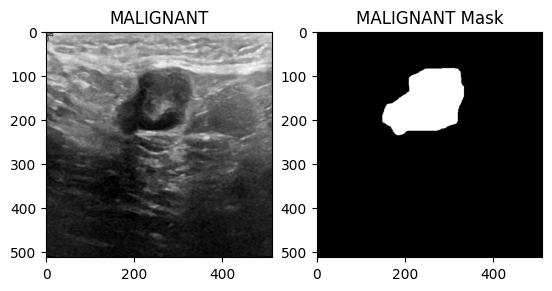

In [14]:
train_dataset = BreastCancerDataset(paths=train_paths, transform=train_transform, mode="train")
val_dataset = BreastCancerDataset(paths=val_paths, transform=test_transform, mode="test")
test_dataset = BreastCancerDataset(paths=test_paths, transform=test_transform, mode="test")

image, mask, label = train_dataset[random.randint(1, len(train_dataset))]
plt.subplot(1, 2, 1)
plt.imshow(unNorm(image).permute(1, 2, 0))
plt.title(label.upper())

plt.subplot(1, 2, 2)
plt.imshow(mask, cmap='gray')
plt.title(f'{label.upper()} Mask')
plt.show()

In [15]:
from collections import Counter

counts=Counter()
for lbl in train_dataset.labels:
    reps=train_dataset.dup_factor if lbl in train_dataset.augment_classes else 1
    counts[lbl]+=reps

print(counts)

Counter({'malignant': 270, 'benign': 227, 'normal': 130})


# Loss

In [16]:
class AverageMeter(object):
    def __init__(self):
        self.reset()
    
    def reset(self):
        self.val = 0
        self.avg = 0
        self.sum = 0
        self.count = 0
    
    def update(self, val, n = 1):
        self.val += val
        self.sum += val * n
        self.count += n
        self.avg = self.sum / self.count

In [17]:
def plot_segmentation_metrics(train_loss, val_loss, train_mean_iou=None, val_mean_iou=None, 
                              train_dice_score=None, val_dice_score=None):
    """
    Plot training and validation metrics (loss, mean IoU, Dice score) over epochs.

    Args:
    - train_loss (list): List of training loss values over epochs.
    - val_loss (list): List of validation loss values over epochs.
    - train_mean_iou (list, optional): List of training mean IoU values over epochs.
    - val_mean_iou (list, optional): List of validation mean IoU values over epochs.
    - train_dice_score (list, optional): List of training Dice score values over epochs.
    - val_dice_score (list, optional): List of validation Dice score values over epochs.
    """
    epochs = range(1, len(train_loss) + 1)
    
    plt.figure(figsize=(15, 10))
    
    # Plotting the Loss
    plt.subplot(2, 2, 1)
    plt.plot(epochs, train_loss, 'r', label='Training Loss')
    plt.plot(epochs, val_loss, 'b', label='Val Loss')
    plt.title('Training and Val Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid()
    
    # Plotting the Mean IoU (if available)
    if train_mean_iou:
        plt.subplot(2, 2, 2)
        plt.plot(epochs, train_mean_iou, 'r', label='Training Mean IoU')
    if val_mean_iou:
        plt.subplot(2, 2, 2)
        plt.plot(epochs, val_mean_iou, 'b', label='Val Mean IoU')
        plt.title('Training and Val Mean IoU')
        plt.xlabel('Epochs')
        plt.ylabel('Mean IoU')
        plt.legend()
        plt.grid()
    
    # Plotting the Dice Score (if available)
    if train_dice_score:
        plt.subplot(2, 2, 3)
        plt.plot(epochs, train_dice_score, 'r', label='Training Dice Score')
    if val_dice_score:
        plt.subplot(2, 2, 3)
        plt.plot(epochs, val_dice_score, 'b', label='Val Dice Score')
        plt.title('Training and Val Dice Score')
        plt.xlabel('Epochs')
        plt.ylabel('Dice Score')
        plt.legend()
        plt.grid()
    
    plt.tight_layout()
    plt.show()

In [18]:
def intersectionAndUnionGPU(output, target, K, ignore_index=255):
    # 'K' classes, output and target sizes are N or N * L or N * H * W, each value in range 0 to K - 1.
    assert (output.dim() in [1, 2, 3])
    assert output.shape == target.shape
    output = output.view(-1)
    target = target.view(-1)
    output[target == ignore_index] = ignore_index
    intersection = output[output == target]
    area_intersection = torch.histc(intersection, bins=K, min=0, max=K-1)
    area_output = torch.histc(output, bins=K, min=0, max=K-1)
    area_target = torch.histc(target, bins=K, min=0, max=K-1)
    area_union = area_output + area_target - area_intersection
    return area_intersection, area_union, area_target

# Train

In [19]:
upsample = nn.Upsample(scale_factor=4, mode='bilinear')

In [20]:
def train(train_dataset, val_dataset, num_class, n_workers, batch_size, lr, epochs, checkpoint, saved_model):
    device = 'cuda' if torch.cuda.is_available() else 'cpu'
    
    # train_dataset = BreastCancerDataset(transform=train_transform)
    train_loader = DataLoader(
        dataset=train_dataset,
        batch_size=batch_size,
        shuffle=True,
        num_workers=n_workers
    )
    
    # val_dataset = BreastCancerDataset(is_train=False, transform=test_transform)
    val_loader = DataLoader(
        dataset=val_dataset,
        batch_size=batch_size,
        num_workers=n_workers
    )

    version = "nvidia/segformer-b3-finetuned-ade-512-512"
    model = SegformerForSemanticSegmentation.from_pretrained(version)
    
    in_channels = model.decode_head.classifier.in_channels
    model.decode_head.classifier = nn.Conv2d(in_channels, num_class, 1, 1)
    model.to(device)
    
    criterion = torch.nn.BCEWithLogitsLoss()
    optimizer = torch.optim.AdamW(params=model.parameters(), lr=lr, weight_decay=1e-4)
    
    num_batch = len(train_loader)
    
    scheduler = torch.optim.lr_scheduler.PolynomialLR(optimizer, total_iters=num_batch*epochs, power=0.9)

    if os.path.isdir(checkpoint):
        shutil.rmtree(checkpoint)
    os.makedirs(checkpoint)
    
    if not os.path.isdir(saved_model):
        os.makedirs(saved_model)
    
    writer = SummaryWriter(checkpoint)
    
    train_loss = []
    val_loss = []
    val_mIoU = []
    val_mDice = []
    intersection_meter = AverageMeter()
    union_meter = AverageMeter()
    train_loss_meter = AverageMeter()
    val_loss_meter = AverageMeter()
    
    no_improvement_counter = 0
    patience = 8
    best_mIoU = -1
    
    for epoch in range(epochs):
        model.train()
        train_loss_meter.reset()
        val_loss_meter.reset()
        intersection_meter.reset()
        union_meter.reset()
        
        progress_bar = tqdm(train_loader, colour='cyan')
        
        for i, (image, mask, __) in enumerate(progress_bar):
            image, mask = image.to(device), mask.to(device)
            
            output = model(image).logits
            output = upsample(output).squeeze()
            loss = criterion(output, mask)
            
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            
            train_loss_meter.update(loss.item())
            progress_bar.set_description(f"Train | Epoch {epoch + 1}/{epochs} | Loss {train_loss_meter.avg:.4f} | lr {optimizer.param_groups[0]['lr']}")
            writer.add_scalar("Train/Loss AVG", train_loss_meter.avg, num_batch * epoch + i)
            writer.add_scalar("Train/Loss", loss.item(), num_batch * epoch + i)
            scheduler.step()
        
        model.eval()
        with torch.no_grad():
            progress_bar = tqdm(iterable=val_loader, colour='yellow')
            
            for image, mask, _ in progress_bar:
                image, mask = image.to(device), mask.to(device)
                
                output = model(image).logits
                output = upsample(output).squeeze()
                loss = criterion(output, mask)
                
                val_loss_meter.update(loss.item())
                output[output>=0.5] = 1
                output[output<0.5] = 0
                output = output.long()
                mask = mask.long()
                
                intersection, union, target = intersectionAndUnionGPU(output, mask, 2)           
                intersection_meter.update(intersection)
                union_meter.update(union)
                
                iou = intersection / (union + 1e-10)
                mean_iou = np.mean(iou.cpu().numpy())
                dice = 2 * intersection / (intersection + union + 1e-10)

                dice_value = dice.mean().item()
                
                intersection_meter.update(intersection)
                union_meter.update(union)
                val_loss_meter.update(loss.item())
                
                progress_bar.set_description(f"Val | Loss {loss.item():.4f} | mIoU: {mean_iou:.4f} | dice: {dice_value:.4f}")
            
            
            iou_class = intersection_meter.sum / (union_meter.sum + 1e-10)
            dice_class = 2 * intersection_meter.sum / (intersection_meter.sum + union_meter.sum + 1e-10)
            
            mIoU = iou_class.mean().item()
            mDice = dice_class.mean().item()
            print(f"Val | Loss {val_loss_meter.avg:.4f} | mIoU: {mIoU:.4f} | dice: {mDice:.4f}")
            
            writer.add_scalar("Val/Loss", val_loss_meter.avg, epoch)
            writer.add_scalar("Val/mIoU", mIoU, epoch)
            writer.add_scalar("Val/dice", mDice, epoch)
            
            checkpoint_data = {
                "model_state_dict": model.state_dict(),
                "optimizer_state_dict": optimizer.state_dict(),
                "epoch": epoch + 1,
                "mIoU": mIoU,
                "mDice": mDice
            }
            
            torch.save(checkpoint_data, os.path.join(saved_model, "last.pt"))
            
            if mIoU > best_mIoU:
                best_mIoU = mIoU
                torch.save(checkpoint_data, os.path.join(saved_model, "best.pt"))
                no_improvement_counter = 0
                print('Patience Reset!')

            else:
                no_improvement_counter += 1
                print('Patience | ' + str(no_improvement_counter) + ' / ' + str(patience))
              
            train_loss.append(train_loss_meter.avg)
            val_loss.append(val_loss_meter.avg)
            val_mIoU.append(mIoU)
            val_mDice.append(mDice)
            
            if no_improvement_counter > patience:
                print("Early stopping!")
                break
    
    plot_segmentation_metrics(train_loss, val_loss, None, val_mIoU, None, val_mDice)


In [21]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(device)

cuda


### Delete GPU Memmory

In [22]:
import gc

for _ in range(3):
    torch.cuda.empty_cache()
    
    gc.collect()

In [23]:
num_class = 1
n_workers = int(os.cpu_count())
# print(n_workers)
batch_size = 8
lr = 1e-4
epochs = 50
checkpoint = "/kaggle/working/tensorboard"
saved_model = "/kaggle/working/saved_model"


config.json: 0.00B [00:00, ?B/s]

pytorch_model.bin:   0%|          | 0.00/190M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/189M [00:00<?, ?B/s]


  0%|          | 0/79 [00:00<?, ?it/s]
Train | Epoch 1/50 | Loss 0.6537 | lr 0.0001:   0%|          | 0/79 [00:04<?, ?it/s]
Train | Epoch 1/50 | Loss 0.6537 | lr 0.0001:   1%|▏         | 1/79 [00:04<06:02,  4.65s/it]
Train | Epoch 1/50 | Loss 0.6492 | lr 9.997721490143132e-05:   1%|▏         | 1/79 [00:06<06:02,  4.65s/it]
Train | Epoch 1/50 | Loss 0.6492 | lr 9.997721490143132e-05:   3%|▎         | 2/79 [00:06<03:57,  3.09s/it]
Train | Epoch 1/50 | Loss 0.6435 | lr 9.995442922587132e-05:   3%|▎         | 2/79 [00:08<03:57,  3.09s/it]
Train | Epoch 1/50 | Loss 0.6435 | lr 9.995442922587132e-05:   4%|▍         | 3/79 [00:08<03:17,  2.59s/it]
Train | Epoch 1/50 | Loss 0.6364 | lr 9.993164297315923e-05:   4%|▍         | 3/79 [00:10<03:17,  2.59s/it]
Train | Epoch 1/50 | Loss 0.6364 | lr 9.993164297315923e-05:   5%|▌         | 4/79 [00:10<02:56,  2.35s/it]
Train | Epoch 1/50 | Loss 0.6317 | lr 9.99088561431342e-05:   5%|▌         | 4/79 [00:12<02:56,  2.35s/it] 
Train | Epoch 1/50 | Loss 

Val | Loss 0.2006 | mIoU: 0.7088 | dice: 0.8074
Patience Reset!


Train | Epoch 2/50 | Loss 0.1989 | lr 9.641556983659432e-05: 100%|██████████| 79/79 [03:01<00:00,  2.30s/it]
Val | Loss 0.2395 | mIoU: 0.6816 | dice: 0.7856: 100%|██████████| 12/12 [00:08<00:00,  1.48it/s]


Val | Loss 0.1645 | mIoU: 0.7785 | dice: 0.8648
Patience Reset!


Train | Epoch 3/50 | Loss 0.1457 | lr 9.460635785829026e-05: 100%|██████████| 79/79 [03:01<00:00,  2.29s/it]
Val | Loss 0.2096 | mIoU: 0.6674 | dice: 0.7719: 100%|██████████| 12/12 [00:08<00:00,  1.50it/s]


Val | Loss 0.1469 | mIoU: 0.7541 | dice: 0.8456
Patience | 1 / 8


Train | Epoch 4/50 | Loss 0.1312 | lr 9.279329312804636e-05: 100%|██████████| 79/79 [03:01<00:00,  2.29s/it]
Val | Loss 0.2210 | mIoU: 0.6426 | dice: 0.7490: 100%|██████████| 12/12 [00:08<00:00,  1.48it/s]


Val | Loss 0.1317 | mIoU: 0.7504 | dice: 0.8425
Patience | 2 / 8


Train | Epoch 5/50 | Loss 0.1170 | lr 9.097628342564044e-05: 100%|██████████| 79/79 [03:01<00:00,  2.30s/it]
Val | Loss 0.2722 | mIoU: 0.6657 | dice: 0.7728: 100%|██████████| 12/12 [00:08<00:00,  1.48it/s]


Val | Loss 0.1603 | mIoU: 0.7668 | dice: 0.8562
Patience | 3 / 8


Train | Epoch 6/50 | Loss 0.1048 | lr 8.915523222264335e-05: 100%|██████████| 79/79 [03:01<00:00,  2.30s/it]
Val | Loss 0.2378 | mIoU: 0.7049 | dice: 0.8068: 100%|██████████| 12/12 [00:08<00:00,  1.49it/s]


Val | Loss 0.1296 | mIoU: 0.7759 | dice: 0.8623
Patience | 4 / 8


Train | Epoch 7/50 | Loss 0.0954 | lr 8.733003837852936e-05: 100%|██████████| 79/79 [03:01<00:00,  2.30s/it]
Val | Loss 0.2217 | mIoU: 0.7201 | dice: 0.8199: 100%|██████████| 12/12 [00:08<00:00,  1.48it/s]


Val | Loss 0.1324 | mIoU: 0.7925 | dice: 0.8750
Patience Reset!


Train | Epoch 8/50 | Loss 0.0866 | lr 8.550059580777431e-05: 100%|██████████| 79/79 [03:01<00:00,  2.30s/it]
Val | Loss 0.2865 | mIoU: 0.6868 | dice: 0.7916: 100%|██████████| 12/12 [00:07<00:00,  1.50it/s]


Val | Loss 0.1406 | mIoU: 0.7857 | dice: 0.8697
Patience | 1 / 8


Train | Epoch 9/50 | Loss 0.0877 | lr 8.366679311441284e-05: 100%|██████████| 79/79 [03:01<00:00,  2.30s/it]
Val | Loss 0.1544 | mIoU: 0.7259 | dice: 0.8255: 100%|██████████| 12/12 [00:08<00:00,  1.48it/s]


Val | Loss 0.1278 | mIoU: 0.7929 | dice: 0.8755
Patience Reset!


Train | Epoch 10/50 | Loss 0.0928 | lr 8.182851319000087e-05: 100%|██████████| 79/79 [03:01<00:00,  2.30s/it]
Val | Loss 0.2058 | mIoU: 0.7573 | dice: 0.8493: 100%|██████████| 12/12 [00:08<00:00,  1.49it/s]


Val | Loss 0.1397 | mIoU: 0.7975 | dice: 0.8788
Patience Reset!


Train | Epoch 11/50 | Loss 0.0837 | lr 7.99856327703115e-05: 100%|██████████| 79/79 [03:01<00:00,  2.29s/it]
Val | Loss 0.3126 | mIoU: 0.6913 | dice: 0.7952: 100%|██████████| 12/12 [00:08<00:00,  1.48it/s]


Val | Loss 0.1411 | mIoU: 0.7886 | dice: 0.8722
Patience | 1 / 8


Train | Epoch 12/50 | Loss 0.0649 | lr 7.813802194535847e-05: 100%|██████████| 79/79 [03:01<00:00,  2.30s/it]
Val | Loss 0.1897 | mIoU: 0.7311 | dice: 0.8296: 100%|██████████| 12/12 [00:08<00:00,  1.48it/s]


Val | Loss 0.1292 | mIoU: 0.7980 | dice: 0.8789
Patience Reset!


Train | Epoch 13/50 | Loss 0.0813 | lr 7.62855436164736e-05: 100%|██████████| 79/79 [03:01<00:00,  2.29s/it]
Val | Loss 0.2616 | mIoU: 0.7088 | dice: 0.8112: 100%|██████████| 12/12 [00:08<00:00,  1.49it/s]


Val | Loss 0.1717 | mIoU: 0.7719 | dice: 0.8603
Patience | 1 / 8


Train | Epoch 14/50 | Loss 0.0695 | lr 7.442805289312787e-05: 100%|██████████| 79/79 [03:01<00:00,  2.29s/it]
Val | Loss 0.3438 | mIoU: 0.6709 | dice: 0.7779: 100%|██████████| 12/12 [00:08<00:00,  1.50it/s]


Val | Loss 0.1798 | mIoU: 0.7677 | dice: 0.8570
Patience | 2 / 8


Train | Epoch 15/50 | Loss 0.0702 | lr 7.25653964209455e-05: 100%|██████████| 79/79 [03:00<00:00,  2.29s/it]
Val | Loss 0.2445 | mIoU: 0.7040 | dice: 0.8070: 100%|██████████| 12/12 [00:08<00:00,  1.50it/s]


Val | Loss 0.1412 | mIoU: 0.7964 | dice: 0.8779
Patience | 3 / 8


Train | Epoch 16/50 | Loss 0.0620 | lr 7.06974116308655e-05: 100%|██████████| 79/79 [03:01<00:00,  2.29s/it]
Val | Loss 0.3604 | mIoU: 0.6639 | dice: 0.7715: 100%|██████████| 12/12 [00:08<00:00,  1.48it/s]


Val | Loss 0.1569 | mIoU: 0.7920 | dice: 0.8748
Patience | 4 / 8


Train | Epoch 17/50 | Loss 0.0668 | lr 6.88239258976025e-05: 100%|██████████| 79/79 [03:01<00:00,  2.29s/it]
Val | Loss 0.4348 | mIoU: 0.6089 | dice: 0.7162: 100%|██████████| 12/12 [00:08<00:00,  1.47it/s]


Val | Loss 0.1721 | mIoU: 0.7745 | dice: 0.8623
Patience | 5 / 8


Train | Epoch 18/50 | Loss 0.0641 | lr 6.694475559335999e-05: 100%|██████████| 79/79 [03:01<00:00,  2.29s/it]
Val | Loss 0.3933 | mIoU: 0.6758 | dice: 0.7825: 100%|██████████| 12/12 [00:08<00:00,  1.49it/s]


Val | Loss 0.1748 | mIoU: 0.7670 | dice: 0.8561
Patience | 6 / 8


Train | Epoch 19/50 | Loss 0.0535 | lr 6.505970502006841e-05: 100%|██████████| 79/79 [03:01<00:00,  2.29s/it]
Val | Loss 0.3720 | mIoU: 0.6408 | dice: 0.7491: 100%|██████████| 12/12 [00:08<00:00,  1.49it/s]


Val | Loss 0.1601 | mIoU: 0.7831 | dice: 0.8682
Patience | 7 / 8


Train | Epoch 20/50 | Loss 0.0521 | lr 6.316856520012172e-05: 100%|██████████| 79/79 [03:01<00:00,  2.29s/it]
Val | Loss 0.3778 | mIoU: 0.6164 | dice: 0.7239: 100%|██████████| 12/12 [00:08<00:00,  1.48it/s]


Val | Loss 0.1549 | mIoU: 0.7871 | dice: 0.8709
Patience | 8 / 8


Train | Epoch 21/50 | Loss 0.0564 | lr 6.127111250150138e-05: 100%|██████████| 79/79 [03:02<00:00,  2.30s/it]
Val | Loss 0.3734 | mIoU: 0.6228 | dice: 0.7281: 100%|██████████| 12/12 [00:08<00:00,  1.48it/s]


Val | Loss 0.1475 | mIoU: 0.7789 | dice: 0.8648
Patience | 9 / 8
Early stopping!


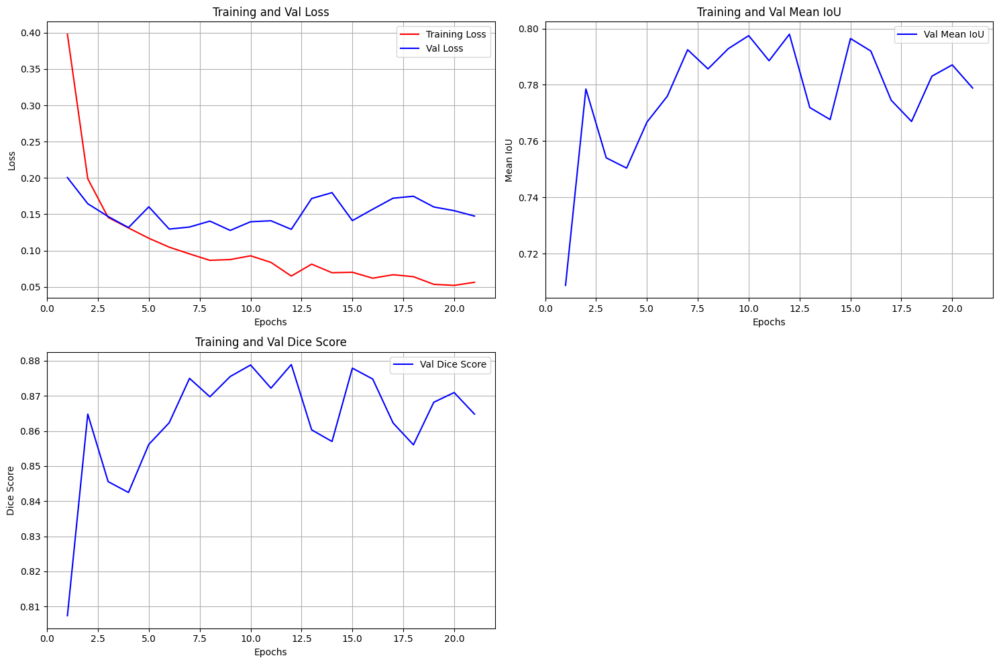

Train | Epoch 1/50 | Loss 0.3914 | lr 9.822101725292989e-05: 100%|██████████| 79/79 [03:01<00:00,  2.30s/it]
Val | Loss 0.2059 | mIoU: 0.7600 | dice: 0.8477: 100%|██████████| 12/12 [00:08<00:00,  1.48it/s]


Val | Loss 0.2054 | mIoU: 0.7334 | dice: 0.8276
Patience Reset!


Train | Epoch 2/50 | Loss 0.2035 | lr 9.641556983659432e-05: 100%|██████████| 79/79 [03:01<00:00,  2.29s/it]
Val | Loss 0.1024 | mIoU: 0.6591 | dice: 0.7512: 100%|██████████| 12/12 [00:08<00:00,  1.48it/s]


Val | Loss 0.1307 | mIoU: 0.7087 | dice: 0.8049
Patience | 1 / 8


Train | Epoch 3/50 | Loss 0.1519 | lr 9.460635785829026e-05: 100%|██████████| 79/79 [03:01<00:00,  2.30s/it]
Val | Loss 0.1086 | mIoU: 0.7428 | dice: 0.8335: 100%|██████████| 12/12 [00:08<00:00,  1.47it/s]


Val | Loss 0.1244 | mIoU: 0.7660 | dice: 0.8538
Patience Reset!


Train | Epoch 4/50 | Loss 0.1270 | lr 9.279329312804636e-05: 100%|██████████| 79/79 [03:01<00:00,  2.30s/it]
Val | Loss 0.0632 | mIoU: 0.7842 | dice: 0.8660: 100%|██████████| 12/12 [00:08<00:00,  1.47it/s]


Val | Loss 0.1122 | mIoU: 0.7615 | dice: 0.8502
Patience | 1 / 8


Train | Epoch 5/50 | Loss 0.1177 | lr 9.097628342564044e-05: 100%|██████████| 79/79 [03:01<00:00,  2.30s/it]
Val | Loss 0.0622 | mIoU: 0.8308 | dice: 0.8999: 100%|██████████| 12/12 [00:08<00:00,  1.48it/s]


Val | Loss 0.1080 | mIoU: 0.7756 | dice: 0.8612
Patience Reset!


Train | Epoch 6/50 | Loss 0.1136 | lr 8.915523222264335e-05: 100%|██████████| 79/79 [03:00<00:00,  2.29s/it]
Val | Loss 0.0636 | mIoU: 0.7254 | dice: 0.8162: 100%|██████████| 12/12 [00:08<00:00,  1.45it/s]


Val | Loss 0.1226 | mIoU: 0.7420 | dice: 0.8340
Patience | 1 / 8


Train | Epoch 7/50 | Loss 0.0913 | lr 8.733003837852936e-05: 100%|██████████| 79/79 [03:01<00:00,  2.30s/it]
Val | Loss 0.0441 | mIoU: 0.8035 | dice: 0.8802: 100%|██████████| 12/12 [00:08<00:00,  1.49it/s]


Val | Loss 0.1089 | mIoU: 0.7736 | dice: 0.8595
Patience | 2 / 8


Train | Epoch 8/50 | Loss 0.0885 | lr 8.550059580777431e-05: 100%|██████████| 79/79 [03:01<00:00,  2.30s/it]
Val | Loss 0.0455 | mIoU: 0.8077 | dice: 0.8833: 100%|██████████| 12/12 [00:08<00:00,  1.47it/s]


Val | Loss 0.1100 | mIoU: 0.7681 | dice: 0.8553
Patience | 3 / 8


Train | Epoch 9/50 | Loss 0.0860 | lr 8.366679311441284e-05: 100%|██████████| 79/79 [03:01<00:00,  2.29s/it]
Val | Loss 0.0614 | mIoU: 0.8221 | dice: 0.8938: 100%|██████████| 12/12 [00:08<00:00,  1.48it/s]


Val | Loss 0.1109 | mIoU: 0.7854 | dice: 0.8687
Patience Reset!


Train | Epoch 10/50 | Loss 0.0873 | lr 8.182851319000087e-05: 100%|██████████| 79/79 [03:01<00:00,  2.29s/it]
Val | Loss 0.0582 | mIoU: 0.8660 | dice: 0.9237: 100%|██████████| 12/12 [00:08<00:00,  1.47it/s]


Val | Loss 0.1170 | mIoU: 0.7801 | dice: 0.8648
Patience | 1 / 8


Train | Epoch 11/50 | Loss 0.0823 | lr 7.99856327703115e-05: 100%|██████████| 79/79 [03:01<00:00,  2.30s/it]
Val | Loss 0.0454 | mIoU: 0.8433 | dice: 0.9086: 100%|██████████| 12/12 [00:08<00:00,  1.47it/s]


Val | Loss 0.1189 | mIoU: 0.7691 | dice: 0.8564
Patience | 2 / 8


Train | Epoch 12/50 | Loss 0.0685 | lr 7.813802194535847e-05: 100%|██████████| 79/79 [03:01<00:00,  2.29s/it]
Val | Loss 0.0610 | mIoU: 0.8389 | dice: 0.9056: 100%|██████████| 12/12 [00:08<00:00,  1.46it/s]


Val | Loss 0.1280 | mIoU: 0.7610 | dice: 0.8503
Patience | 3 / 8


Train | Epoch 13/50 | Loss 0.0641 | lr 7.62855436164736e-05: 100%|██████████| 79/79 [03:01<00:00,  2.29s/it]
Val | Loss 0.0404 | mIoU: 0.8266 | dice: 0.8969: 100%|██████████| 12/12 [00:08<00:00,  1.48it/s]


Val | Loss 0.1127 | mIoU: 0.7777 | dice: 0.8629
Patience | 4 / 8


Train | Epoch 14/50 | Loss 0.0633 | lr 7.442805289312787e-05: 100%|██████████| 79/79 [03:01<00:00,  2.29s/it]
Val | Loss 0.0598 | mIoU: 0.7916 | dice: 0.8718: 100%|██████████| 12/12 [00:08<00:00,  1.47it/s]


Val | Loss 0.1244 | mIoU: 0.7813 | dice: 0.8659
Patience | 5 / 8


Train | Epoch 15/50 | Loss 0.0638 | lr 7.25653964209455e-05: 100%|██████████| 79/79 [03:00<00:00,  2.29s/it]
Val | Loss 0.0356 | mIoU: 0.8547 | dice: 0.9162: 100%|██████████| 12/12 [00:08<00:00,  1.47it/s]


Val | Loss 0.1218 | mIoU: 0.7714 | dice: 0.8581
Patience | 6 / 8


Train | Epoch 16/50 | Loss 0.0682 | lr 7.06974116308655e-05: 100%|██████████| 79/79 [03:01<00:00,  2.30s/it]
Val | Loss 0.0560 | mIoU: 0.7801 | dice: 0.8629: 100%|██████████| 12/12 [00:08<00:00,  1.48it/s]


Val | Loss 0.1312 | mIoU: 0.7763 | dice: 0.8619
Patience | 7 / 8


Train | Epoch 17/50 | Loss 0.0694 | lr 6.88239258976025e-05: 100%|██████████| 79/79 [03:01<00:00,  2.29s/it]
Val | Loss 0.0613 | mIoU: 0.8479 | dice: 0.9119: 100%|██████████| 12/12 [00:08<00:00,  1.50it/s]


Val | Loss 0.1142 | mIoU: 0.7952 | dice: 0.8762
Patience Reset!


Train | Epoch 18/50 | Loss 0.0614 | lr 6.694475559335999e-05: 100%|██████████| 79/79 [03:01<00:00,  2.29s/it]
Val | Loss 0.0409 | mIoU: 0.8274 | dice: 0.8977: 100%|██████████| 12/12 [00:08<00:00,  1.49it/s]


Val | Loss 0.1234 | mIoU: 0.7834 | dice: 0.8672
Patience | 1 / 8


Train | Epoch 19/50 | Loss 0.0578 | lr 6.505970502006841e-05: 100%|██████████| 79/79 [03:01<00:00,  2.30s/it]
Val | Loss 0.0725 | mIoU: 0.7866 | dice: 0.8680: 100%|██████████| 12/12 [00:08<00:00,  1.49it/s]


Val | Loss 0.1409 | mIoU: 0.7461 | dice: 0.8380
Patience | 2 / 8


Train | Epoch 20/50 | Loss 0.0547 | lr 6.316856520012172e-05: 100%|██████████| 79/79 [03:01<00:00,  2.30s/it]
Val | Loss 0.0731 | mIoU: 0.7811 | dice: 0.8642: 100%|██████████| 12/12 [00:08<00:00,  1.48it/s]


Val | Loss 0.1179 | mIoU: 0.8003 | dice: 0.8797
Patience Reset!


Train | Epoch 21/50 | Loss 0.0543 | lr 6.127111250150138e-05: 100%|██████████| 79/79 [03:01<00:00,  2.29s/it]
Val | Loss 0.0685 | mIoU: 0.7894 | dice: 0.8703: 100%|██████████| 12/12 [00:08<00:00,  1.49it/s]


Val | Loss 0.1233 | mIoU: 0.7998 | dice: 0.8793
Patience | 1 / 8


Train | Epoch 22/50 | Loss 0.0498 | lr 5.9367107068095535e-05: 100%|██████████| 79/79 [03:01<00:00,  2.29s/it]
Val | Loss 0.1565 | mIoU: 0.6693 | dice: 0.7706: 100%|██████████| 12/12 [00:08<00:00,  1.49it/s]


Val | Loss 0.1433 | mIoU: 0.7704 | dice: 0.8581
Patience | 2 / 8


Train | Epoch 23/50 | Loss 0.0541 | lr 5.745629101964255e-05: 100%|██████████| 79/79 [03:01<00:00,  2.30s/it]
Val | Loss 0.0440 | mIoU: 0.7813 | dice: 0.8632: 100%|██████████| 12/12 [00:08<00:00,  1.49it/s]


Val | Loss 0.1168 | mIoU: 0.7969 | dice: 0.8770
Patience | 3 / 8


Train | Epoch 24/50 | Loss 0.0504 | lr 5.553838637767092e-05: 100%|██████████| 79/79 [03:01<00:00,  2.29s/it]
Val | Loss 0.0645 | mIoU: 0.8185 | dice: 0.8916: 100%|██████████| 12/12 [00:08<00:00,  1.48it/s]


Val | Loss 0.1463 | mIoU: 0.7678 | dice: 0.8557
Patience | 4 / 8


Train | Epoch 25/50 | Loss 0.0455 | lr 5.361309266354007e-05: 100%|██████████| 79/79 [03:01<00:00,  2.29s/it]
Val | Loss 0.1041 | mIoU: 0.7680 | dice: 0.8540: 100%|██████████| 12/12 [00:08<00:00,  1.48it/s]


Val | Loss 0.1443 | mIoU: 0.7722 | dice: 0.8590
Patience | 5 / 8


Train | Epoch 26/50 | Loss 0.0479 | lr 5.1680084101496e-05: 100%|██████████| 79/79 [03:00<00:00,  2.29s/it]
Val | Loss 0.1133 | mIoU: 0.7426 | dice: 0.8339: 100%|██████████| 12/12 [00:08<00:00,  1.49it/s]


Val | Loss 0.1527 | mIoU: 0.7710 | dice: 0.8581
Patience | 6 / 8


Train | Epoch 27/50 | Loss 0.0446 | lr 4.9739006342547946e-05: 100%|██████████| 79/79 [03:01<00:00,  2.29s/it]
Val | Loss 0.1067 | mIoU: 0.7526 | dice: 0.8418: 100%|██████████| 12/12 [00:08<00:00,  1.48it/s]


Val | Loss 0.1525 | mIoU: 0.7705 | dice: 0.8578
Patience | 7 / 8


Train | Epoch 28/50 | Loss 0.0462 | lr 4.7789472602564586e-05: 100%|██████████| 79/79 [03:01<00:00,  2.29s/it]
Val | Loss 0.0811 | mIoU: 0.7538 | dice: 0.8426: 100%|██████████| 12/12 [00:08<00:00,  1.49it/s]


Val | Loss 0.1660 | mIoU: 0.7606 | dice: 0.8503
Patience | 8 / 8


Train | Epoch 29/50 | Loss 0.0434 | lr 4.583105907831776e-05: 100%|██████████| 79/79 [03:01<00:00,  2.29s/it]
Val | Loss 0.0506 | mIoU: 0.8147 | dice: 0.8888: 100%|██████████| 12/12 [00:07<00:00,  1.50it/s]


Val | Loss 0.1563 | mIoU: 0.7594 | dice: 0.8491
Patience | 9 / 8
Early stopping!


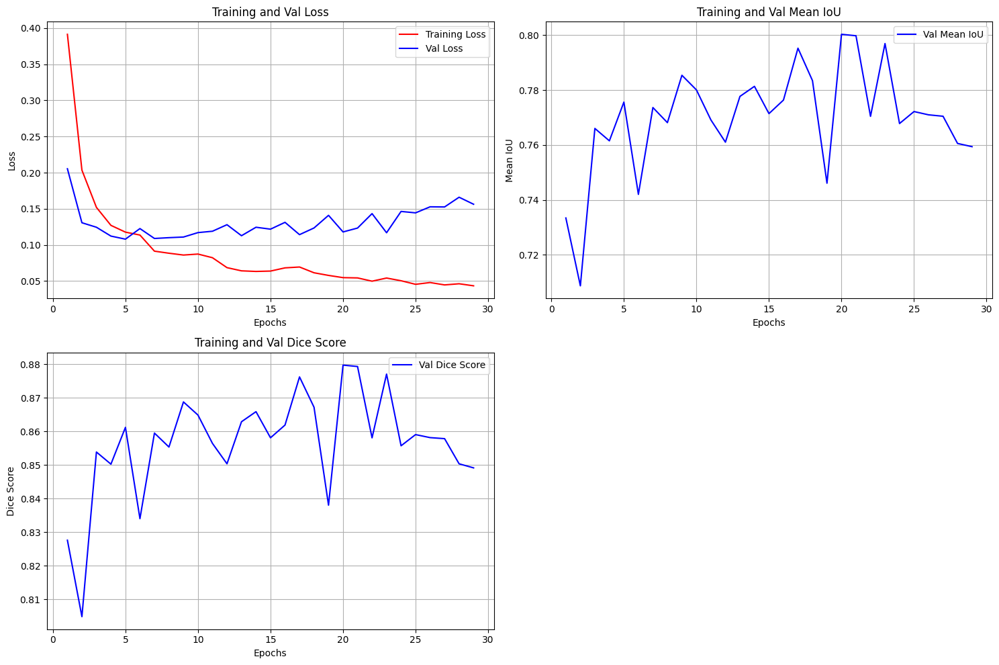

Train | Epoch 1/50 | Loss 0.4282 | lr 9.822101725292989e-05: 100%|██████████| 79/79 [03:01<00:00,  2.30s/it]
Val | Loss 0.1272 | mIoU: 0.7455 | dice: 0.8346: 100%|██████████| 12/12 [00:08<00:00,  1.50it/s]


Val | Loss 0.1771 | mIoU: 0.6782 | dice: 0.7770
Patience Reset!


Train | Epoch 2/50 | Loss 0.2046 | lr 9.641556983659432e-05: 100%|██████████| 79/79 [03:01<00:00,  2.29s/it]
Val | Loss 0.0972 | mIoU: 0.8142 | dice: 0.8884: 100%|██████████| 12/12 [00:08<00:00,  1.50it/s]


Val | Loss 0.1431 | mIoU: 0.7497 | dice: 0.8406
Patience Reset!


Train | Epoch 3/50 | Loss 0.1610 | lr 9.460635785829026e-05: 100%|██████████| 79/79 [03:01<00:00,  2.29s/it]
Val | Loss 0.0700 | mIoU: 0.8293 | dice: 0.8992: 100%|██████████| 12/12 [00:08<00:00,  1.49it/s]


Val | Loss 0.1253 | mIoU: 0.7851 | dice: 0.8686
Patience Reset!


Train | Epoch 4/50 | Loss 0.1308 | lr 9.279329312804636e-05: 100%|██████████| 79/79 [03:01<00:00,  2.30s/it]
Val | Loss 0.0642 | mIoU: 0.8005 | dice: 0.8784: 100%|██████████| 12/12 [00:08<00:00,  1.49it/s]


Val | Loss 0.1002 | mIoU: 0.7859 | dice: 0.8691
Patience Reset!


Train | Epoch 5/50 | Loss 0.1158 | lr 9.097628342564044e-05: 100%|██████████| 79/79 [03:01<00:00,  2.29s/it]
Val | Loss 0.0465 | mIoU: 0.8731 | dice: 0.9284: 100%|██████████| 12/12 [00:08<00:00,  1.49it/s]


Val | Loss 0.1010 | mIoU: 0.7950 | dice: 0.8759
Patience Reset!


Train | Epoch 6/50 | Loss 0.1095 | lr 8.915523222264335e-05: 100%|██████████| 79/79 [03:01<00:00,  2.30s/it]
Val | Loss 0.0403 | mIoU: 0.8652 | dice: 0.9233: 100%|██████████| 12/12 [00:08<00:00,  1.50it/s]


Val | Loss 0.1007 | mIoU: 0.7980 | dice: 0.8783
Patience Reset!


Train | Epoch 7/50 | Loss 0.0952 | lr 8.733003837852936e-05: 100%|██████████| 79/79 [03:00<00:00,  2.29s/it]
Val | Loss 0.0402 | mIoU: 0.8097 | dice: 0.8851: 100%|██████████| 12/12 [00:07<00:00,  1.50it/s]


Val | Loss 0.1104 | mIoU: 0.7900 | dice: 0.8723
Patience | 1 / 8


Train | Epoch 8/50 | Loss 0.0944 | lr 8.550059580777431e-05: 100%|██████████| 79/79 [03:01<00:00,  2.29s/it]
Val | Loss 0.0374 | mIoU: 0.8688 | dice: 0.9256: 100%|██████████| 12/12 [00:08<00:00,  1.48it/s]


Val | Loss 0.1020 | mIoU: 0.8107 | dice: 0.8875
Patience Reset!


Train | Epoch 9/50 | Loss 0.0884 | lr 8.366679311441284e-05: 100%|██████████| 79/79 [03:01<00:00,  2.30s/it]
Val | Loss 0.0593 | mIoU: 0.7875 | dice: 0.8685: 100%|██████████| 12/12 [00:08<00:00,  1.49it/s]


Val | Loss 0.0935 | mIoU: 0.7933 | dice: 0.8744
Patience | 1 / 8


Train | Epoch 10/50 | Loss 0.0879 | lr 8.182851319000087e-05: 100%|██████████| 79/79 [03:00<00:00,  2.29s/it]
Val | Loss 0.0313 | mIoU: 0.8967 | dice: 0.9431: 100%|██████████| 12/12 [00:08<00:00,  1.48it/s]


Val | Loss 0.0990 | mIoU: 0.8157 | dice: 0.8910
Patience Reset!


Train | Epoch 11/50 | Loss 0.0737 | lr 7.99856327703115e-05: 100%|██████████| 79/79 [03:01<00:00,  2.30s/it]
Val | Loss 0.0331 | mIoU: 0.8729 | dice: 0.9282: 100%|██████████| 12/12 [00:07<00:00,  1.50it/s]


Val | Loss 0.1065 | mIoU: 0.7983 | dice: 0.8786
Patience | 1 / 8


Train | Epoch 12/50 | Loss 0.0770 | lr 7.813802194535847e-05: 100%|██████████| 79/79 [03:01<00:00,  2.29s/it]
Val | Loss 0.0410 | mIoU: 0.8454 | dice: 0.9103: 100%|██████████| 12/12 [00:07<00:00,  1.50it/s]


Val | Loss 0.0822 | mIoU: 0.8335 | dice: 0.9031
Patience Reset!


Train | Epoch 13/50 | Loss 0.0804 | lr 7.62855436164736e-05: 100%|██████████| 79/79 [03:01<00:00,  2.29s/it]
Val | Loss 0.0653 | mIoU: 0.7650 | dice: 0.8507: 100%|██████████| 12/12 [00:08<00:00,  1.49it/s]


Val | Loss 0.0955 | mIoU: 0.7732 | dice: 0.8591
Patience | 1 / 8


Train | Epoch 14/50 | Loss 0.0728 | lr 7.442805289312787e-05: 100%|██████████| 79/79 [03:01<00:00,  2.30s/it]
Val | Loss 0.0337 | mIoU: 0.8757 | dice: 0.9301: 100%|██████████| 12/12 [00:08<00:00,  1.49it/s]


Val | Loss 0.0873 | mIoU: 0.8091 | dice: 0.8860
Patience | 2 / 8


Train | Epoch 15/50 | Loss 0.0623 | lr 7.25653964209455e-05: 100%|██████████| 79/79 [03:00<00:00,  2.29s/it]
Val | Loss 0.0346 | mIoU: 0.8422 | dice: 0.9080: 100%|██████████| 12/12 [00:07<00:00,  1.50it/s]


Val | Loss 0.0967 | mIoU: 0.7871 | dice: 0.8698
Patience | 3 / 8


Train | Epoch 16/50 | Loss 0.0689 | lr 7.06974116308655e-05: 100%|██████████| 79/79 [03:01<00:00,  2.29s/it]
Val | Loss 0.0345 | mIoU: 0.8839 | dice: 0.9352: 100%|██████████| 12/12 [00:08<00:00,  1.49it/s]


Val | Loss 0.0981 | mIoU: 0.8040 | dice: 0.8824
Patience | 4 / 8


Train | Epoch 17/50 | Loss 0.0622 | lr 6.88239258976025e-05: 100%|██████████| 79/79 [03:01<00:00,  2.30s/it]
Val | Loss 0.0427 | mIoU: 0.8481 | dice: 0.9121: 100%|██████████| 12/12 [00:08<00:00,  1.50it/s]


Val | Loss 0.0977 | mIoU: 0.7896 | dice: 0.8718
Patience | 5 / 8


Train | Epoch 18/50 | Loss 0.0599 | lr 6.694475559335999e-05: 100%|██████████| 79/79 [03:01<00:00,  2.29s/it]
Val | Loss 0.0354 | mIoU: 0.8415 | dice: 0.9076: 100%|██████████| 12/12 [00:08<00:00,  1.49it/s]


Val | Loss 0.0987 | mIoU: 0.8058 | dice: 0.8838
Patience | 6 / 8


Train | Epoch 19/50 | Loss 0.0543 | lr 6.505970502006841e-05: 100%|██████████| 79/79 [03:00<00:00,  2.29s/it]
Val | Loss 0.0364 | mIoU: 0.8572 | dice: 0.9181: 100%|██████████| 12/12 [00:07<00:00,  1.50it/s]


Val | Loss 0.0988 | mIoU: 0.8068 | dice: 0.8844
Patience | 7 / 8


Train | Epoch 20/50 | Loss 0.0603 | lr 6.316856520012172e-05: 100%|██████████| 79/79 [03:01<00:00,  2.29s/it]
Val | Loss 0.0250 | mIoU: 0.9063 | dice: 0.9489: 100%|██████████| 12/12 [00:08<00:00,  1.50it/s]


Val | Loss 0.0937 | mIoU: 0.8106 | dice: 0.8873
Patience | 8 / 8


Train | Epoch 21/50 | Loss 0.0560 | lr 6.127111250150138e-05: 100%|██████████| 79/79 [03:01<00:00,  2.29s/it]
Val | Loss 0.0266 | mIoU: 0.8924 | dice: 0.9405: 100%|██████████| 12/12 [00:08<00:00,  1.49it/s]


Val | Loss 0.1262 | mIoU: 0.7904 | dice: 0.8732
Patience | 9 / 8
Early stopping!


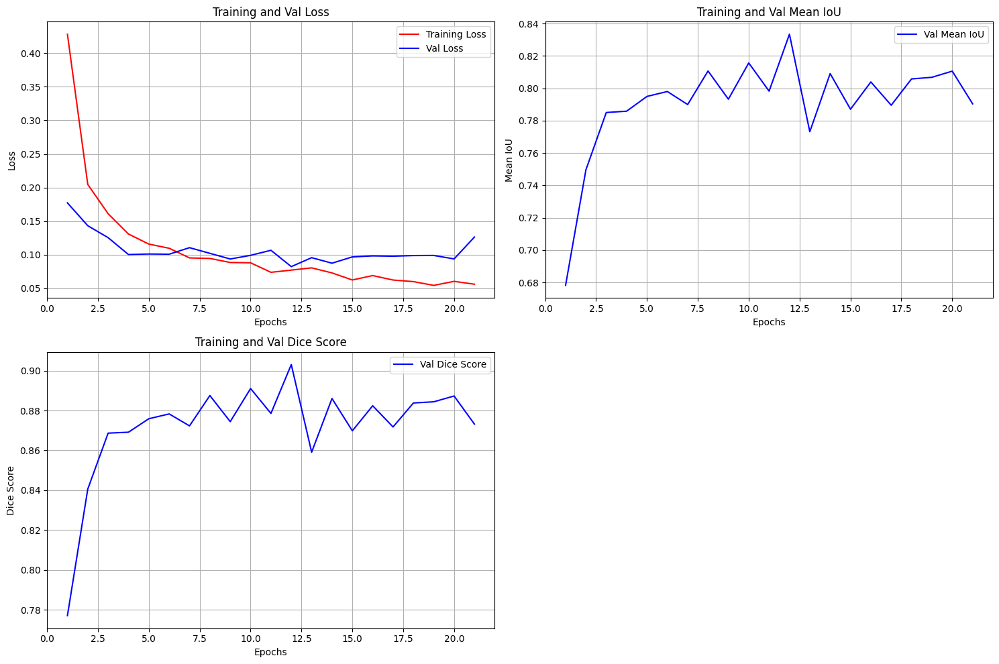

In [24]:
SEEDS = [150, 42, 8]
for run, SEED in enumerate(SEEDS):
    if run:
        train_paths, val_paths, test_paths = create_splits(root, seed=SEED)
        test_splits.append(test_paths)

        train_dataset = BreastCancerDataset(paths=train_paths, transform=train_transform, mode="train")
        val_dataset = BreastCancerDataset(paths=val_paths, transform=test_transform, mode="test")
        # test_dataset = BreastCancerDataset(paths=test_paths, transform=test_transform, mode="test")
    if do_train:
        train(train_dataset, val_dataset, num_class, n_workers, batch_size, lr, epochs, checkpoint + str(run), saved_model + str(run))
        

# Inference

In [25]:
def pred_show_best_worst_per_label(model_pth, device, test_dataset, num_class, num_worst=6, num_best=2):
    # Load model checkpoint
    checkpoint = torch.load(model_pth, map_location=device)
    
    # Initialize and load model state
    model_name = "nvidia/segformer-b3-finetuned-ade-512-512"
    model = SegformerForSemanticSegmentation.from_pretrained(model_name)
    in_channels = model.decode_head.classifier.in_channels
    model.decode_head.classifier = nn.Conv2d(in_channels, num_class, 1, 1)
    model.to(device)
    
    model.load_state_dict(checkpoint['model_state_dict'])
    model.eval()

    # Dict to store per-category results
    results_by_label = {label: [] for label in test_dataset.labels}

    with torch.no_grad():
        for idx in range(len(test_dataset)):
            ori_img, orig_mask, label = test_dataset[idx]
            img = ori_img.float().to(device).unsqueeze(0)

            # Get logits and prob map
            logits = model(img).logits
            prob_mask = torch.sigmoid(upsample(logits)).squeeze().cpu().numpy()  # shape (H,W)
            pred_mask = (prob_mask >= 0.5).astype(np.uint8)
            
            # Predict mask
            pred_mask = upsample(model(img).logits).squeeze()
            pred_mask[pred_mask>=0.5] = 1
            pred_mask[pred_mask<0.5] = 0
            pred_mask = pred_mask.long()

            # Compute IoU
            intersection, union, _ = intersectionAndUnionGPU(pred_mask, orig_mask.long().to(device), K=num_class)
            iou = (intersection / (union + 1e-10)).mean().item()

            # Infer label from file path
            # path = test_dataset.path[idx]
            # label = os.path.basename(os.path.dirname(path))  # e.g., benign/malignant/normal

            # Reconstruct RGB image
            img_np = unNorm(ori_img).permute(1,2,0).numpy()  # shape (H,W,3), float in [0,1]
            img_uint8 = (img_np * 255).astype(np.uint8)

            # Generate heatmap
            heatmap = cv2.applyColorMap((prob_mask*255).astype(np.uint8), cv2.COLORMAP_JET)
            heatmap_overlay = cv2.addWeighted(img_uint8, 0.6, heatmap, 0.4, 0)

            results_by_label[label].append((
                idx, iou, img_uint8, orig_mask.numpy(), pred_mask.cpu().numpy(), heatmap_overlay
            ))

            # results_by_label[label].append((
            #     idx,
            #     iou,
            #     unNorm(ori_img).permute(1,2,0),
            #     orig_mask.numpy(),
            #     pred_mask.cpu().numpy()
            # ))

    # Plot worst and best per category
    for label, results in results_by_label.items():
        if not results:
            continue
        results.sort(key=lambda x: x[1])  # sort by IoU

        worst_samples = results[:num_worst]
        best_samples = results[-num_best:]
        display_samples = worst_samples + best_samples

        fig = plt.figure(figsize=(24, 12))
        fig.suptitle(f"{label.upper()} - {num_worst} Worst and {num_best} Best Predictions", fontsize=16)

        for i, (idx, iou, img, gt, pred, heatmap_overlay) in enumerate(display_samples, 1):
            fig.add_subplot(3, len(display_samples), i)
            plt.imshow(img)
            plt.title(f"Image {idx}\nIoU={iou:.4f}")
            plt.axis("off")

            fig.add_subplot(3, len(display_samples), i + len(display_samples))
            plt.imshow(pred, cmap="gray")

            # Add ground truth contour
            contours,_ = cv2.findContours(gt.astype(np.uint8), cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
            for contour in contours:
                plt.plot(contour[:,0,0], contour[:,0,1], color='red', linewidth=1.5)

            plt.title("Prediction + GT Contour")
            plt.axis("off")

            fig.add_subplot(3, len(display_samples), i + 2*len(display_samples))
            plt.imshow(heatmap_overlay)
            plt.title("Heatmap Overlay")
            plt.axis("off")

        plt.tight_layout()
        plt.show()


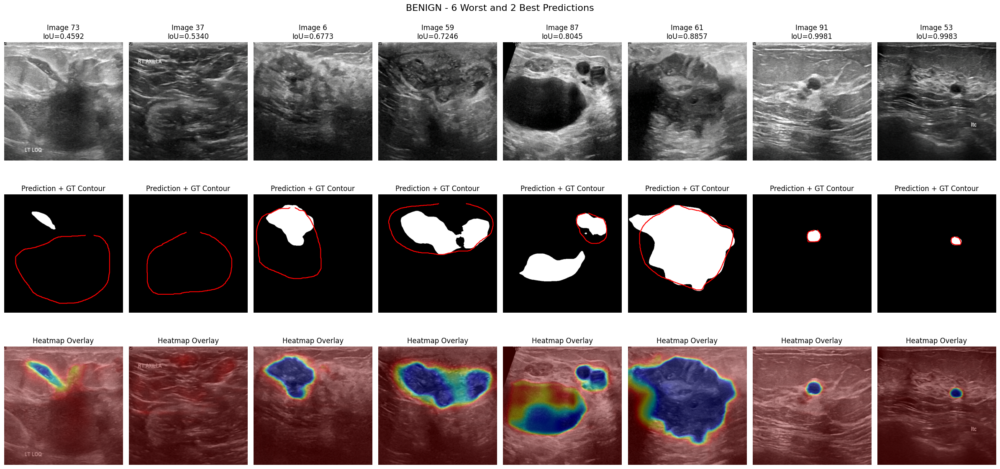

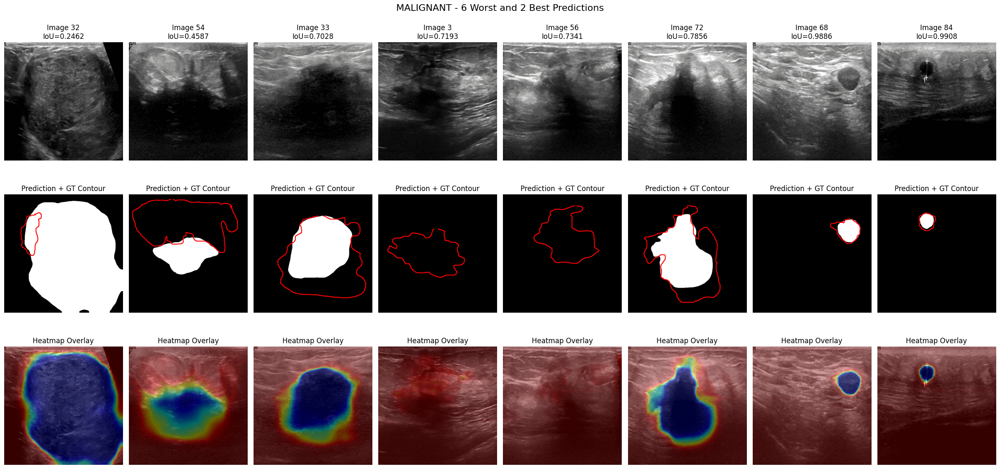

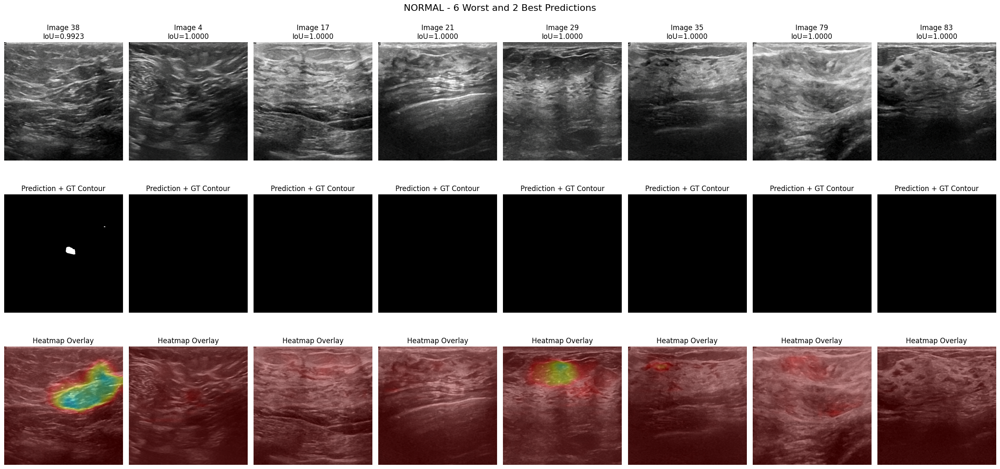

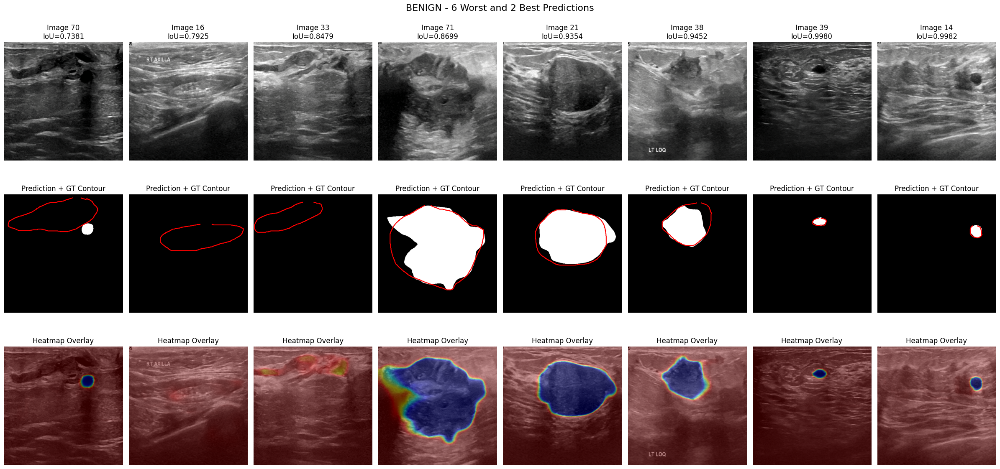

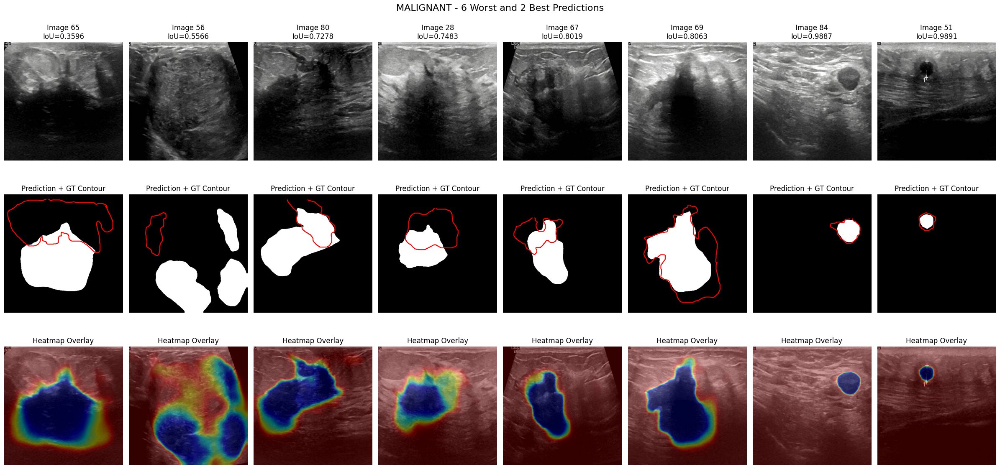

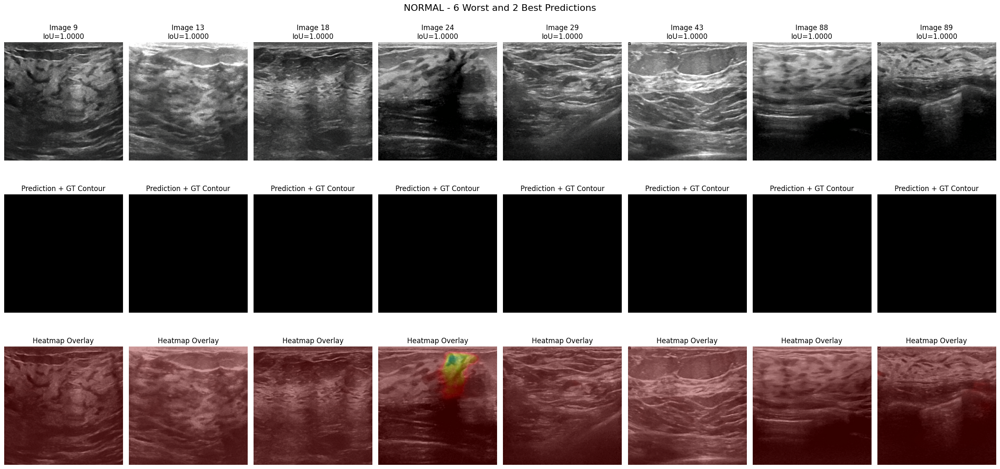

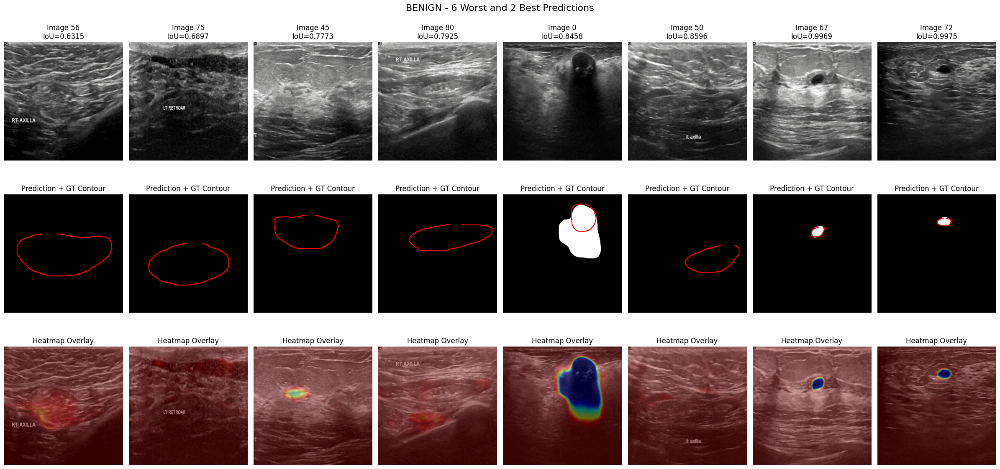

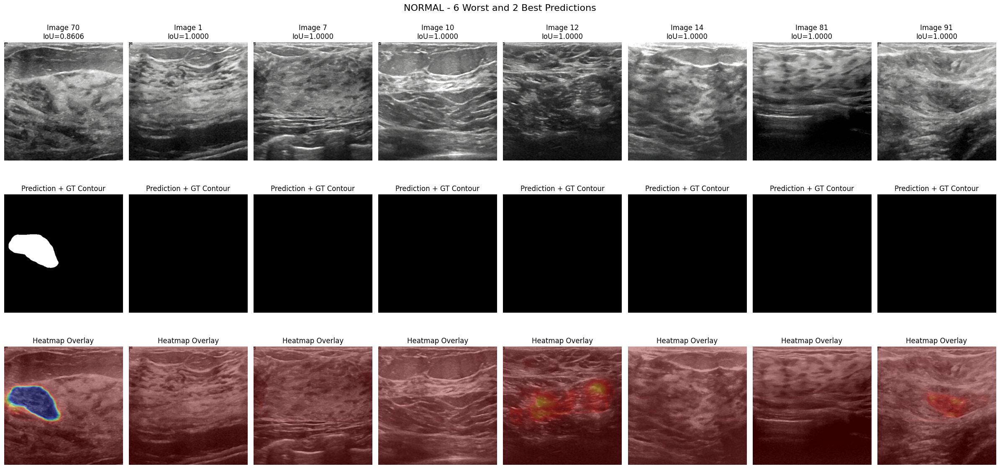

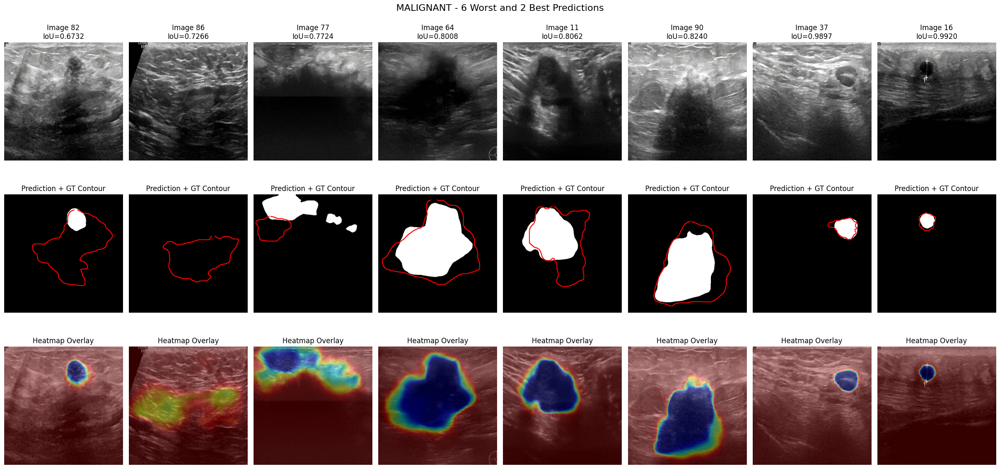

In [26]:
for run in range(len(SEEDS)):
    if do_train:
        model_pth = "/kaggle/working/saved_model/best.pt"
    else:
        model_pth = "/kaggle/input/breast-cancer-ultrasound-segmentation-segformer/saved_model/best.pt"

    # Find insertion point (right after 'saved_model')
    insertion_point = model_pth.find('saved_model') + len('saved_model')
    # Construct new string with number inserted
    new_path = model_pth[:insertion_point] + str(run) + model_pth[insertion_point:]
    
    test_dataset = BreastCancerDataset(paths=test_splits[run], transform=test_transform, mode="test")

    pred_show_best_worst_per_label(new_path, device, test_dataset, num_class, num_worst=6, num_best=2)

In [27]:
len(test_dataset)

92